

# Project: Wrangling and Analyzing Data

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a>
<ul>
    <li><a href="#gather">Data Gathering</a></li>
    <li><a href="#assess">Assessing Data</a></li>
    <li><a href="#clean">Cleaning Data</a></li>
    </ul>
</li>
<li><a href="#store">Storing Data</a></li>
<li><a href="#analysis">Analyzing and Visualizing Data</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

### Dataset Description 

This Dataset is a tweet archive for the twitter user **@dog_rates** also known as **WeRateDogs**. It is a twitter account that rates people's dog with a comical comment about the dog. The aim of this project is to wrangle it's archive data from 3 different sources to gather a data frame which will then be cleaned and data analysis and visualtion performed for the data.


In [348]:
# Importing all packages that would be needed

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import datetime
import requests
from PIL import Image
from io import BytesIO
from IPython.display import display
import json
import os
import re
from pandas import *
import tweepy
from tweepy import OAuthHandler
from matplotlib import rcParams
from timeit import default_timer as timer
from wordcloud import WordCloud
%matplotlib inline



> We need to install the packages that we would be using durin this project

In [ ]:
#Installing word cloud
import sys
!{sys.executable} -m pip install wordcloud

In [ ]:
#Installing tweepy to access twitter API
import sys
!{sys.executable} -m pip install tweepy

<a id='wrangling'></a>
## Data Wrangling

<a id='gather'></a>
### Data Gathering

Here all the data required to perform analysis from the 3 different sources are gotten

**1. twitter_archive_enhanced.csv file**

In [ ]:
# Read the already downloaded twitter_archive_enhanced.csv file into pandas dataframe
twitter_archive = pd.read_csv('twitter-archive-enhanced.csv')

# Check sample to verify loaded content
twitter_archive.sample(5)


**2. The Tweet Image Prediction.tsv file - To be downloaded programatically**

In [6]:
# Download the image prediction.tsv file from UDACITY server using the URL provided
url  = 'https://d17h27t6h515a5.cloudfront.net/topher/2017/August/599fd2ad_image-predictions/image-predictions.tsv'
response = requests.get(url)
file_name = url.split('/')[-1]
with open(file_name, 'wb') as file:
        file.write(response.content)
        
#Read the file into pandas dataframe
image_predictions= pd.read_csv('image-predictions.tsv', sep = '\t')

# Check sample to verify loaded content
image_predictions.sample(5)

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
1054,714251586676113411,https://pbs.twimg.com/media/CemIBt4WwAQqhVV.jpg,2,soft-coated_wheaten_terrier,0.751962,True,Bedlington_terrier,0.175652,True,Great_Pyrenees,0.011452,True
1661,811744202451197953,https://pbs.twimg.com/media/C0PlCQjXAAA9TIh.jpg,1,Pekinese,0.386082,True,Labrador_retriever,0.202862,True,golden_retriever,0.170487,True
1732,821149554670182400,https://pbs.twimg.com/ext_tw_video_thumb/82114...,1,German_shepherd,0.515933,True,malinois,0.203651,True,Irish_setter,0.091055,True
1421,772102971039580160,https://pbs.twimg.com/media/CrcPjh0WcAA_SPT.jpg,1,Pembroke,0.541780,True,Cardigan,0.260504,True,Shetland_sheepdog,0.063703,True
1155,733109485275860992,https://pbs.twimg.com/media/CiyHLocU4AI2pJu.jpg,1,golden_retriever,0.945523,True,Labrador_retriever,0.042319,True,doormat,0.003956,False


**3. Additional Data from Twitter Api**

In [ ]:
# Create 'keys.py' for Twitter API tokens and secrets
file_name = 'twitterkeys.py'

%%writefile {twitterkeys.py}    # Enter your tokens and secrets here. Remove them only at submission

consumer_key=""
consumer_secret=""
access_token=""
access_token_secret=""

In [ ]:
# Load keys from 'twitterkeys.py'
from keys import *
consumer_key = consumer_key
consumer_secret = consumer_secret
access_token = access_token
access_secret = access_secret

In [23]:
#Creating a twitter API Object
auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)

api = tweepy.API(auth, wait_on_rate_limit=True)
                
#api = tweepy.API(auth,wait_on_rate_limit=True,wait_on_rate_limit_notify=True)


#Query Twitter's API for JSON data relating to each tweet ID in the Twitter archive

tweet_ids = twitter_archive.tweet_id.values

count = 0
start = timer()
failed_dict = {}

# Each JSON data for tweet returned is saved in a .txt file in a new line
with open('tweet_json.txt', 'w') as output:
    for tweet_id in tweet_ids:
        #count += 1
        #print(str(count) + ": " + str(tweet_id))
        try:
            tweet = api.get_status(tweet_id, tweet_mode='extended')
            json_text=json.dump(tweet._json., output)
            output.write('\n')
        except tweepy.errors.TweepyException as e:
            fails_dict[tweet_id] = e
            pass
end =timer()
print(end-start)
print(failed_dict)

Rate limit reached. Sleeping for: 312
Rate limit reached. Sleeping for: 327


2161.0860981000005
{}


> From the above we can see how long it took for the line of code to work approximately 22mins without having exception

In [24]:
#This code checks the count of tweet_id contained in the archive
len(tweet_ids)

2356

In [25]:
# An empty dictonary is created and the data extracted from the JSON file are appended to the dictionary
# This is used to create a dataframe

twitter_list = []
with open ('tweet_json.txt', 'r') as data:
    for line in data:
        tweets = json.loads(line)
        
        tweet_id = tweets['id']
        retweet_count = tweets['retweet_count']
        favorite_count = tweets['favorite_count']
        
        twitter_list.append({'tweet_id' : tweet_id,
                         'retweet_count' : retweet_count,
                         'favorite_count':favorite_count})

twitter_api = pd.DataFrame(twitter_list)

In [26]:
#Checking samples of the newly created dataframe

twitter_api.sample(5)

,tweet_id,retweet_count,favorite_count
2052,670815497391357952,1313,2773
1055,738402415918125056,737,3000
1226,710609963652087808,2151,4422
1223,710844581445812225,610,2348
2306,666273097616637952,66,151


<a id='assess'></a>
### Assessing Data

We would be assessing the data in two ways

1. Visual Assessment (viewing the data using excel etc)
2. Programmatic assessment (using pandas method)


### Visual Assessment

In [29]:
#Let's view the data visually

#twitter_archive data

twitter_archive.tail(5)


,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
2351,666049248165822465,NaN,NaN,2015-11-16 00:24:50 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a 1949 1st generation vulpix. Enj...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666049248...,5,10,None,None,None,None,None
2352,666044226329800704,NaN,NaN,2015-11-16 00:04:52 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is a purebred Piers Morgan. Loves to Netf...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666044226...,6,10,a,None,None,None,None
2353,666033412701032449,NaN,NaN,2015-11-15 23:21:54 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here is a very happy pup. Big fan of well-main...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666033412...,9,10,a,None,None,None,None
2354,666029285002620928,NaN,NaN,2015-11-15 23:05:30 +0000,"<a href=""http://twitter.com/download/iphone"" r...",This is a western brown Mitsubishi terrier. Up...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666029285...,7,10,a,None,None,None,None
2355,666020888022790149,NaN,NaN,2015-11-15 22:32:08 +0000,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a Japanese Irish Setter. Lost eye...,NaN,NaN,NaN,https://twitter.com/dog_rates/status/666020888...,8,10,None,None,None,None,None


In [38]:
#View the image prediction dataframe visually

image_predictions.sample(5)

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
1400,768609597686943744,https://pbs.twimg.com/media/CqqmWa7WcAAIM-n.jpg,1,basenji,0.183283,True,Italian_greyhound,0.136012,True,whippet,0.060130,True
846,695314793360662529,https://pbs.twimg.com/media/CaZBErSWEAEdXk_.jpg,2,Maltese_dog,0.678547,True,Lhasa,0.125046,True,Pekinese,0.048999,True
1867,843856843873095681,https://pbs.twimg.com/media/C7X7Ui0XgAA3m19.jpg,1,Labrador_retriever,0.922540,True,golden_retriever,0.074358,True,Great_Pyrenees,0.002325,True
616,680191257256136705,https://pbs.twimg.com/media/CXCGVXyWsAAAVHE.jpg,1,Brittany_spaniel,0.733253,True,Welsh_springer_spaniel,0.251634,True,English_springer,0.009243,True
1320,756288534030475264,https://pbs.twimg.com/media/Cn7gaHrWIAAZJMt.jpg,3,conch,0.925621,False,French_bulldog,0.032492,True,tiger_cat,0.006679,False


In [31]:
#View the twitter api dataframe visually

twitter_api.tail(5)

,tweet_id,retweet_count,favorite_count
2321,666049248165822465,36,88
2322,666044226329800704,115,246
2323,666033412701032449,36,100
2324,666029285002620928,39,112
2325,666020888022790149,419,2283


#### Visual Quality Issues

##### `twitter_archive_enhanced` table

- Missing values in the 5 Columns (retweeted_status_timestamp,  retweeted_status_user_id,retweeted_status_id,in_reply_to_status_id and in_reply_to_user_id).
- Some tweets containing retweets are part of the dataframe, original ratings should be used as per specification.


##### `image prediction` table
- Lesser data at 2074 than the twitter_archive_enhanced file which is 2356.
- Inconsistent alphabet casing values in the **p1**, **p2** and **p3** columns.
- Inconsistent decimal places in the prediciton confidence columns.
- Non descriptive column header.

##### `twitter API` table
- Lesser data at 2325 than the twitter_archive_enhanced file which is 2356 but more than the image prediction file at 2074.

#### Visual Tidiness Issues

##### `twitter_archive_enhanced` table

- Various stages(*doggo*, *floofer*, *pupper* and *floofer*) of the dog can be classified under one column.
- Source column has some HTML before the actual source.

##### `image prediction` table
- Three variables in six columns(**p1,p1_conf	,p1_dog, p2	,p2_conf,p2_dog,p3,p3_conf,p3_dog**).


### Programmatic Assessment

In [33]:
# Let'd view the dataframes progmmatically using some pandas functions

#Check for datatypes and Null values in the twitter_archive_enhanced dataframe
twitter_archive.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 

In [35]:
# Check eeach column for null values in the twitter_archive_enhanced dataframe

twitter_archive.isnull().sum()

tweet_id                         0
in_reply_to_status_id         2278
in_reply_to_user_id           2278
timestamp                        0
source                           0
text                             0
retweeted_status_id           2175
retweeted_status_user_id      2175
retweeted_status_timestamp    2175
expanded_urls                   59
rating_numerator                 0
rating_denominator               0
name                             0
doggo                            0
floofer                          0
pupper                           0
puppo                            0
dtype: int64

In [36]:
#Check for duplicates in the twitter_archive_enhanced dataframe

twitter_archive.duplicated().sum()

0

In [39]:
#Check count of name values in the twitter_archive_enhanced dataframe

twitter_archive.name.value_counts()

None          745
a              55
Charlie        12
Cooper         11
Lucy           11
             ... 
Dex             1
Ace             1
Tayzie          1
Grizzie         1
Christoper      1
Name: name, Length: 957, dtype: int64

In [37]:
#Checking for duplicates in the image predictions dataframe

image_predictions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [41]:
image_predictions.isnull().sum()

tweet_id    0
jpg_url     0
img_num     0
p1          0
p1_conf     0
p1_dog      0
p2          0
p2_conf     0
p2_dog      0
p3          0
p3_conf     0
p3_dog      0
dtype: int64

In [44]:
#Check for duplicates in the image_predictions enhanced dataframe

image_predictions.duplicated().sum()

0

In [45]:
#Check for null values in the image_predictions enhanced dataframe

image_predictions.isnull().sum()

tweet_id    0
jpg_url     0
img_num     0
p1          0
p1_conf     0
p1_dog      0
p2          0
p2_conf     0
p2_dog      0
p3          0
p3_conf     0
p3_dog      0
dtype: int64

In [46]:
#Checking for duplicates in the twitter API dataframe

twitter_api.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2326 entries, 0 to 2325
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   tweet_id        2326 non-null   int64
 1   retweet_count   2326 non-null   int64
 2   favorite_count  2326 non-null   int64
dtypes: int64(3)
memory usage: 54.6 KB


In [47]:
#Check for duplicates in the twitter API dataframe

twitter_api.duplicated().sum()

0

#### Programatic Quality Issues

##### `twitter_archive_enhanced` table
.
- Incomplete and null values for 6 columns namely(in_reply_to_status_id, in_reply_to_user_id,retweeted_status_id,retweeted_status_user_id, retweeted_status_timestamp, expanded_urls).
- Original ratings that have images in the expanded url column should also be used as per specification.
- Incorrect data type for the timestamp column.
- Incorrect data type for the tweetid column.
- Incorrect name of dog as "a","o" ,"the", "actually" etc in the name column.

##### `image prediction` table
- incorrect data type for the tweet_id column.

##### `twitter API` table
- incorrect data type for tweet_id column.

### Cleaning Summary

#### Quality Issues

##### `twitter_archive_enhanced` table
- Some tweets containing Retweets are part of the dataframe, original ratings should be used as per specification.
- Original ratings that have images in the expanded url column should also be used as per specification.
- Incomplete and null values for 6 columns namely(in_reply_to_status_id, in_reply_to_user_id,retweeted_status_id,retweeted_status_user_id, retweeted_status_timestamp, expanded_urls).
- Incorrect data type for the timestamp column.
- Incorrect data type for the tweetid column.
- Incorrect name of dog as "a","o" ,"the", "actually" etc in the name column.

##### `image prediction` table
- lesser data at 2074 than the twitter_archive_enhanced file which is 2356.
- Inconsistent alphabet casing values in the **p1**, **p2** and **p3** columns.
- incorrect data type for the tweet_id column.
- Non descriptive column header.
- Inconsistent decimal places in the prediction confidence columns.

##### `twitter API` table
- lesser data at 2325 than the twitter_archive_enhanced file which is 2356 but more than the image prediction file at 2074
- incorrect data type for tweet_id column.


#### Tidness Issues

##### `twitter_archive_enhanced` table
- various stages(*doggo*, *floofer*, *pupper* and *floofer*) of the dog can be classified under one column in the `twitter_archive_enhanced` table.
- The Source column has some URL before the actual twitter source in the `twitter_archive_enhanced` table.
- Three variables in six columns(**p1,p1_conf,p1_dog, p2,p2_conf,p2_dog,p3,p3_conf,p3_dog**)
- Data in the 3 dataframes are all related to the same object Dog and it's ratings but seperated.



<a id='clean'></a>
### Cleaning Data



In [118]:
#Make a copy of all dataframes before proceeding to clean and tidy and dirty and messy data

twitter_copy = twitter_archive.copy()
predictions_copy = image_predictions.copy()
api_copy = twitter_api.copy()

### Rows with Retweet

#### `twitter_copy`: Table contains rows with retweet values and this has to be removed to meet project specification

##### Define
Remove rows that have retweet and replies using the columns **in_reply_to_status_id** and **retweeted_status_id** from the `twitter_copy`dataframe

##### Code

In [119]:
#Get the index of rows having retweets and reply
retweet_yes = twitter_copy[pd.notnull(twitter_copy['retweeted_status_id'])].index
reply_yes = twitter_copy[pd.notnull(twitter_copy['in_reply_to_status_id'])].index

#Drop those index
twitter_copy.drop(index=retweet_yes, inplace=True)
twitter_copy.drop(index=reply_yes, inplace=True)

##### Test

In [120]:
#Checking the information of those dropped rows
twitter_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2097 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2097 non-null   int64  
 1   in_reply_to_status_id       0 non-null      float64
 2   in_reply_to_user_id         0 non-null      float64
 3   timestamp                   2097 non-null   object 
 4   source                      2097 non-null   object 
 5   text                        2097 non-null   object 
 6   retweeted_status_id         0 non-null      float64
 7   retweeted_status_user_id    0 non-null      float64
 8   retweeted_status_timestamp  0 non-null      object 
 9   expanded_urls               2094 non-null   object 
 10  rating_numerator            2097 non-null   int64  
 11  rating_denominator          2097 non-null   int64  
 12  name                        2097 non-null   object 
 13  doggo                       2097 

> Number of rows has been reduced from 2356 to 2097

### Incomplete and Null Values

#### `twitter_copy`: Null values in 6 columns (in_reply_to_status_id, in_reply_to_user_id,retweeted_status_id,retweeted_status_user_id, retweeted_status_timestamp, expanded_urls)

##### Define
Remove columns with missing values in the `twitter_copy` data frame, however, we won't be removing expanded_urls column but focus only on those with 0 value

##### Code

In [128]:
#Create a loop to drop the 5 columns 
column_names = ['in_reply_to_status_id', 'in_reply_to_user_id', 'retweeted_status_id',
        'retweeted_status_user_id', 'retweeted_status_timestamp']

for i in column_names:
    twitter_copy = twitter_copy.drop([i], axis = 1)

##### Test

In [129]:
#Check to see if the 5 columns has been dropped
twitter_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2097 entries, 0 to 2355
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   tweet_id            2097 non-null   int64 
 1   timestamp           2097 non-null   object
 2   source              2097 non-null   object
 3   text                2097 non-null   object
 4   expanded_urls       2094 non-null   object
 5   rating_numerator    2097 non-null   int64 
 6   rating_denominator  2097 non-null   int64 
 7   name                2097 non-null   object
 8   doggo               2097 non-null   object
 9   floofer             2097 non-null   object
 10  pupper              2097 non-null   object
 11  puppo               2097 non-null   object
dtypes: int64(3), object(9)
memory usage: 213.0+ KB


> All five columns with Nan values has been dropped, now left with 11 columns

### Original Ratings with Images

#### `twitter_copy`, Tables contains column expanded_urls with some missing URL for images

##### Define
Drop rows having no images in the expanded_urls column from the dataframe `twitter_copy`

##### Code

In [149]:
#Drop rows having null values
twitter_copy = twitter_copy[twitter_copy['expanded_urls'].notna()]

##### Test

In [150]:
#Checking to see the number of null value
twitter_copy['expanded_urls'].isnull().sum()

0

In [151]:
#Checking for null value
twitter_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2094 entries, 0 to 2355
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2094 non-null   object             
 1   timestamp           2094 non-null   datetime64[ns, UTC]
 2   text                2094 non-null   object             
 3   expanded_urls       2094 non-null   object             
 4   rating_numerator    2094 non-null   int64              
 5   rating_denominator  2094 non-null   int64              
 6   name                2094 non-null   object             
 7   dog_stage           2094 non-null   object             
 8   tweet_source        2094 non-null   object             
dtypes: datetime64[ns, UTC](1), int64(2), object(6)
memory usage: 163.6+ KB


> No Null value in for the expanded URL in the dataframe and total records is now 2094

### Incorrect Data Type for Tweet ID

#### `twitter_copy`,`predictions_copy` and `api_copy` ,: Tables contains tweetID with incorrect datatype

##### Define
Fix the incorrect data type of column tweetid from integer to string/object in the 3 dataframes

##### Code

In [130]:
#Conversion is done using astype and to_datetime function of pandas

twitter_copy.tweet_id = twitter_copy.tweet_id.astype('str')
predictions_copy.tweet_id = predictions_copy.tweet_id.astype('str')
api_copy.tweet_id = api_copy.tweet_id.astype('str')


##### Test

In [131]:
twitter_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2097 entries, 0 to 2355
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   tweet_id            2097 non-null   object
 1   timestamp           2097 non-null   object
 2   source              2097 non-null   object
 3   text                2097 non-null   object
 4   expanded_urls       2094 non-null   object
 5   rating_numerator    2097 non-null   int64 
 6   rating_denominator  2097 non-null   int64 
 7   name                2097 non-null   object
 8   doggo               2097 non-null   object
 9   floofer             2097 non-null   object
 10  pupper              2097 non-null   object
 11  puppo               2097 non-null   object
dtypes: int64(2), object(10)
memory usage: 213.0+ KB


In [132]:
predictions_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   object 
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(1), object(5)
memory usage: 152.1+ KB


In [133]:
api_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2326 entries, 0 to 2325
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   tweet_id        2326 non-null   object
 1   retweet_count   2326 non-null   int64 
 2   favorite_count  2326 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 54.6+ KB


> The data types has been modified to string accordingly

### Incorrect Data Type for column Timestamp

#### `twitter_copy`: Tables contains timestamp with incorrect datatype

##### Define
Fix the incorrect data type of column timestamp from object to date time in the `twitter_copy` dataframe

##### Code

In [134]:
twitter_copy.timestamp = pd.to_datetime(twitter_copy.timestamp)

##### Test

In [135]:
twitter_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2097 entries, 0 to 2355
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2097 non-null   object             
 1   timestamp           2097 non-null   datetime64[ns, UTC]
 2   source              2097 non-null   object             
 3   text                2097 non-null   object             
 4   expanded_urls       2094 non-null   object             
 5   rating_numerator    2097 non-null   int64              
 6   rating_denominator  2097 non-null   int64              
 7   name                2097 non-null   object             
 8   doggo               2097 non-null   object             
 9   floofer             2097 non-null   object             
 10  pupper              2097 non-null   object             
 11  puppo               2097 non-null   object             
dtypes: datetime64[ns, UTC](1), int64(2

> Timestamp updated with the datetime data type

### Various Dog stages in different columns rather than one

#### `twitter_copy`: Tables contains 4 types of dog stages in different columns rather than only one

##### Define
Create a new column `dog_stages` and put the various dog stages (*doggo*, *floofer*, *pupper* and *floofer*) column under it for the `twitter_copy` dataframe

##### Code

In [136]:
#Create a list for the columns
dog_stage = ['doggo', 'floofer', 'pupper', 'puppo']

#Create a loop to replace the None in the 4 columns with space ''
for s in dog_stage:
    twitter_copy[s] = twitter_copy[s].replace('None','')

In [137]:
#Concatenating all the various dog stages into one single column
twitter_copy['dog_stage'] = twitter_copy.doggo+twitter_copy.floofer+twitter_copy.pupper+twitter_copy.puppo

In [138]:
# Replace empty strings with None
twitter_copy['dog_stage'] = twitter_copy.dog_stage.replace('','None')

In [139]:
#Replacing the combined dog stages with a seperated one with a "-"

twitter_copy.loc[twitter_copy.dog_stage == 'doggofloofer', 'dog_stage'] = 'doggo-floofer'
twitter_copy.loc[twitter_copy.dog_stage == 'doggopuppo', 'dog_stage'] = 'doggo-puppo'
twitter_copy.loc[twitter_copy.dog_stage == 'doggopupper', 'dog_stage'] = 'doggo-pupper'

In [140]:
# Dropping columns doggo,floofer,pupper and puppo
twitter_copy= twitter_copy.drop(['doggo','floofer','pupper','puppo'],axis=1)

##### Test

In [141]:
#Displays random sample of the twitter copy dataframe
twitter_copy.sample(5)

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage
444,819238181065359361,2017-01-11 17:42:57+00:00,"<a href=""http://twitter.com"" rel=""nofollow"">Tw...",Some happy pupper news to share. 10/10 for eve...,http://us.blastingnews.com/news/2017/01/200-do...,10,10,None,pupper
1958,673580926094458881,2015-12-06 19:13:01+00:00,"<a href=""http://twitter.com/download/iphone"" r...",When you ask your professor about extra credit...,https://twitter.com/dog_rates/status/673580926...,8,10,None,None
440,819924195358416896,2017-01-13 15:08:56+00:00,"<a href=""http://twitter.com/download/iphone"" r...",Here we have a doggo who has messed up. He was...,https://twitter.com/dog_rates/status/819924195...,11,10,None,doggo
1042,743895849529389061,2016-06-17 19:59:26+00:00,"<a href=""http://twitter.com/download/iphone"" r...",When you're given AUX cord privileges from the...,https://twitter.com/dog_rates/status/743895849...,10,10,None,None
1083,738537504001953792,2016-06-03 01:07:16+00:00,"<a href=""http://twitter.com/download/iphone"" r...",This is Bayley. She fell asleep trying to esca...,https://twitter.com/dog_rates/status/738537504...,11,10,Bayley,puppo


In [142]:
#Check the unique values of the dog_stage column
twitter_copy.dog_stage.unique()

array(['None', 'doggo', 'puppo', 'pupper', 'floofer', 'doggo-puppo',
       'doggo-floofer', 'doggo-pupper'], dtype=object)

> New column **dog_stage** created and the values of the other columns populated in it

### Source columns contains URL as well as actual Tweet source embedded

#### `twitter_copy`: Source column has the actual tweet source embedded in a URL

##### Define
Create a new column `tweet_source` and extract the actual tweet source from the URL in the `source` column

##### Code

In [143]:
#Using regular expressions to extract the actual source 
twitter_copy['tweet_source'] = twitter_copy.source.str.extract(r'(?<=>)(.*)(?=<)')

In [144]:
#Drop Source column
twitter_copy= twitter_copy.drop(['source'],axis=1)

##### Test

In [145]:
#Show the new values of source
twitter_copy.tweet_source.value_counts()

Twitter for iPhone     1964
Vine - Make a Scene      91
Twitter Web Client       31
TweetDeck                11
Name: tweet_source, dtype: int64

In [181]:
#Displays random sample data
twitter_copy.sample(5)

,tweet_id,timestamp,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_source
34,885528943205470208,2017-07-13 15:58:47+00:00,This is Maisey. She fell asleep mid-excavation...,https://twitter.com/dog_rates/status/885528943...,13,10,Maisey,None,Twitter for iPhone
1019,746790600704425984,2016-06-25 19:42:08+00:00,When you just can't resist... 10/10 topnotch t...,https://twitter.com/dog_rates/status/746790600...,10,10,None,None,Twitter for iPhone
296,837366284874571778,2017-03-02 18:17:34+00:00,This is Lucy. She has a portrait of herself on...,https://twitter.com/dog_rates/status/837366284...,13,10,Lucy,None,Twitter for iPhone
1423,697995514407682048,2016-02-12 04:07:53+00:00,"""Dammit hooman quit playin I jus wanna wheat t...",https://twitter.com/dog_rates/status/697995514...,11,10,None,None,Twitter for iPhone
433,820690176645140481,2017-01-15 17:52:40+00:00,The floofs have been released I repeat the flo...,https://twitter.com/dog_rates/status/820690176...,84,70,None,None,Twitter for iPhone


> Actual source extracted from the HTML and the new column **twitter_source** with the values extracted

### Incorrect Dog Naming

#### `twitter_copy`: The column name has some incorrect dog names such a, o, with most beginning with lower case

##### Define
Replace all lower case names of dogs with None in the `twitter_copy` table

##### Code

In [179]:
#Replace all True Boolean value returned with None
twitter_copy['name'][twitter_copy['name'].str.match('[a-z]+')] = 'None'

C:\Users\Jenny\AppData\Local\Temp\ipykernel_17640\2657099900.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  twitter_copy['name'][twitter_copy['name'].str.match('[a-z]+')] = 'None'


##### Test

In [182]:
#Cross checking the total count of None values
twitter_copy.name.value_counts()

None          704
Lucy           11
Charlie        11
Oliver         10
Cooper         10
             ... 
Shelby          1
Sephie          1
Bonaparte       1
Wishes          1
Christoper      1
Name: name, Length: 930, dtype: int64

### Non Descriptive Column Headers

#### `predictions_copy`: The column headers(p1, p2, p3, p1_conf,p2_conf, p3_conf,p1_dog, p2_dog,p3_dog) are non descriptive.

##### Define
Replace the column headers (p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf and p3_dog) in the `predictions_copy` table with a more descriptive header.

##### Code

In [247]:
#Replacing the column headers with a more descriptive one
predictions_copy = predictions_copy.rename(columns={'p1':'breed_1', 'p1_conf':'conf_1', 'p1_dog':'outcome_1', 
                                                    'p2':'breed_2', 'p2_conf':'conf_2', 'p2_dog':'outcome_2', 
                                                    'p3':'breed_3', 'p3_conf':'conf_3', 'p3_dog':'outcome_3'})

##### Test

In [248]:
#Check to see the new column headers
predictions_copy.columns

Index(['tweet_id', 'jpg_url', 'img_num', 'breed_1', 'conf_1', 'outcome_1',
       'breed_2', 'conf_2', 'outcome_2', 'breed_3', 'conf_3', 'outcome_3'],
      dtype='object')

> A clearer header has been given to the columns

### Inconsistent alphabet casing 

#### `predictions_copy`: Inconsistent casing in the ** dog breeds** values column

##### Define
Convert values in the columns `breed_1`,`breed_2`,`breed_3` of the `predictions_copy` table to lower case

##### Code

In [214]:
#Covert values for columns in the list to lowercase
cols = ['breed_1','breed_2','breed_3']
for col in cols:
  predictions_copy[col] = predictions_copy[col].str.lower()

##### Test

In [202]:
#Check the updated column
predictions_copy[['breed_1', 'breed_2', 'breed_3']].head()

,breed_1,breed_2,breed_3
0,welsh_springer_spaniel,collie,shetland_sheepdog
1,redbone,miniature_pinscher,rhodesian_ridgeback
2,german_shepherd,malinois,bloodhound
3,rhodesian_ridgeback,redbone,miniature_pinscher
4,miniature_pinscher,rottweiler,doberman


> All values in the breed column headers are all in lower case

### Inconsistent decimal places in the prediction confidence columns

#### `predictions_copy`: Inconsistencies in the pred_conf1, pred_conf2 and pred_conf3 values. Some values are 6 decimal while others are greater than 6 decimal places. 

##### Define
Round up all the values in `conf_1`, `conf_2` and `conf_3` in the `predictions_copy` table to 3 decimal places

##### Code

In [249]:
#Round up the values to 3 decimal places.
predictions_copy[['conf_1', 'conf_2', 'conf_3']] = round(predictions_copy[['conf_1', 'conf_2', 'conf_3']],3)

##### Test

In [250]:
#Check to confirm if the changes has been applied to the 3 columns
predictions_copy[['conf_1', 'conf_2', 'conf_3']].head()

,conf_1,conf_2,conf_3
0,0.465,0.157,0.061
1,0.507,0.074,0.072
2,0.596,0.139,0.116
3,0.408,0.361,0.223
4,0.560,0.244,0.155


> The values has been rounded up to 3 decimal places

###  Three variables in six columns

#### `predictions_copy`: The 6 Columns (breed_1,conf_1,outcome_1, breed_2,conf_2,outcome_2,breed_3,conf_3,outcome_3) can be bundled into 3 columns for better visiblity. 

##### Define
Bundle the 6 columns and create 4 columns out of it using the panda 'wide_to_long' function.

##### Code

In [251]:
#Creating 4 columns from existing 6 columns having the"-" seperator out of the prediction copy table
predictions_copy=pd.wide_to_long(predictions_copy, 
                stubnames=['breed','conf','outcome'], 
                i=['tweet_id', 'jpg_url', 'img_num'], 
                j='pred', sep="_").reset_index()

##### Test

In [252]:
#using the assert statement to validate that code worked well
assert 'conf' in predictions_copy
assert 'breed' in predictions_copy
assert 'outcome' in predictions_copy
assert 'pred'in predictions_copy
assert 'breed_1' not in predictions_copy

In [253]:
#checking random sample from the dataframe.
predictions_copy.sample(5)

,tweet_id,jpg_url,img_num,pred,breed,conf,outcome
1402,675047298674663426,https://pbs.twimg.com/media/CV4_8FgXAAQOj4S.jpg,1,2,chow,0.007,True
1357,674752233200820224,https://pbs.twimg.com/media/CV0zkzEU4AAzLc5.jpg,2,2,redbone,0.173,True
2278,688804835492233216,https://pbs.twimg.com/media/CY8gWFRWUAAm1XL.jpg,3,2,German_shepherd,0.097,True
3653,743595368194129920,https://pbs.twimg.com/media/ClHICHmXEAI_1PS.jpg,1,3,warthog,0.019,False
227,667405339315146752,https://pbs.twimg.com/media/CUMZnmhUEAEbtis.jpg,1,3,golden_retriever,0.069,True


> The` predictions_copy` has much better visiblity with fewer columns 

###  Data in the 3 dataframes are all related to the same object Dog ratings but separated

#### `twitter_copy`,`predictions_copy`,`api_copy`: Data in the seperate tables are all related to dog and its ratings. They should be in one table

##### Define
The dataframes `twitter_copy`, `predictions_copy`,`api_copy` should be merged on the common column **tweet_id**

##### Code

In [254]:
#Merge twitter_copy and predictions_copy on tweet_id
twitter_predictions= pd.merge(twitter_copy, predictions_copy, on='tweet_id')

In [255]:
#Merge twitter_predictions and twitter_api on tweet_id
twitter_archive_clean= pd.merge(twitter_predictions, api_copy, on='tweet_id')

##### Test

In [256]:
#Confirm that the 3 tables have been merged
twitter_archive_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5886 entries, 0 to 5885
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            5886 non-null   object             
 1   timestamp           5886 non-null   datetime64[ns, UTC]
 2   text                5886 non-null   object             
 3   expanded_urls       5886 non-null   object             
 4   rating_numerator    5886 non-null   int64              
 5   rating_denominator  5886 non-null   int64              
 6   name                5886 non-null   object             
 7   dog_stage           5886 non-null   object             
 8   tweet_source        5886 non-null   object             
 9   jpg_url             5886 non-null   object             
 10  img_num             5886 non-null   int64              
 11  pred                5886 non-null   int64              
 12  breed               5886 non-null 

> We now have 17 columns and 5886 non-null data/rows

<a id='store'></a>
## Storing Data


In [257]:
#Cleaned data can now be stored in a .csv file
twitter_archive_clean.to_csv('twitter_archive_master.csv', encoding ='utf-8', index = False)

In [258]:
#Load Check the new dataframe from .csv file
df = pd.read_csv('twitter_archive_master.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5886 entries, 0 to 5885
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   tweet_id            5886 non-null   int64  
 1   timestamp           5886 non-null   object 
 2   text                5886 non-null   object 
 3   expanded_urls       5886 non-null   object 
 4   rating_numerator    5886 non-null   int64  
 5   rating_denominator  5886 non-null   int64  
 6   name                5886 non-null   object 
 7   dog_stage           5886 non-null   object 
 8   tweet_source        5886 non-null   object 
 9   jpg_url             5886 non-null   object 
 10  img_num             5886 non-null   int64  
 11  pred                5886 non-null   int64  
 12  breed               5886 non-null   object 
 13  conf                5886 non-null   float64
 14  outcome             5886 non-null   bool   
 15  retweet_count       5886 non-null   int64  
 16  favori

> Notice that the timestamp datatype has been changed after loading, we need to change it back

In [259]:
#Change the data type of timestamp to datetime and check
df.timestamp = pd.to_datetime(df.timestamp, format = '%Y-%m-%d %H:%M:%S')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5886 entries, 0 to 5885
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            5886 non-null   int64              
 1   timestamp           5886 non-null   datetime64[ns, UTC]
 2   text                5886 non-null   object             
 3   expanded_urls       5886 non-null   object             
 4   rating_numerator    5886 non-null   int64              
 5   rating_denominator  5886 non-null   int64              
 6   name                5886 non-null   object             
 7   dog_stage           5886 non-null   object             
 8   tweet_source        5886 non-null   object             
 9   jpg_url             5886 non-null   object             
 10  img_num             5886 non-null   int64              
 11  pred                5886 non-null   int64              
 12  breed               5886 non-null 

<a id='analysis'></a>
## Analyzing and Visualizing Data


In [260]:
#Check the statistical values of the numeric data
df.describe()

,tweet_id,rating_numerator,rating_denominator,img_num,pred,conf,retweet_count,favorite_count
count,5.886000e+03,5886.000000,5886.000000,5886.000000,5886.000000,5886.000000,5886.000000,5886.000000
mean,7.357830e+17,12.224771,10.479613,1.201325,2.000000,0.262990,2247.072375,7728.544852
std,6.745671e+16,41.722288,6.867740,0.558312,0.816566,0.291023,4019.984069,11385.970697
min,6.660209e+17,0.000000,2.000000,1.000000,1.000000,0.000000,11.000000,66.000000
25%,6.758228e+17,10.000000,10.000000,1.000000,1.000000,0.051000,494.000000,1644.000000
50%,7.085954e+17,11.000000,10.000000,1.000000,2.000000,0.135000,1079.500000,3472.500000
75%,7.878106e+17,12.000000,10.000000,1.000000,3.000000,0.379000,2571.000000,9618.000000
max,8.924206e+17,1776.000000,170.000000,4.000000,3.000000,1.000000,70344.000000,144273.000000


> From this, we can see that total count of data in our dataframe is **5886**

> Average number of images is **1**

> A **100%** prediction accuracy.

In [345]:
#Basic setup for Visualization, creating functions for labels and title
def plotlabels(xlabel, ylabel, title):
    plt.xlabel(xlabel);
    plt.ylabel(ylabel);
    plt.title(title);
    return plotlabels

#Specify the size 
plt.rcParams['figure.figsize'] = [12, 9]

#Specify color
c = sns.color_palette()[0]

#### Heat Map to Display correlation between variables

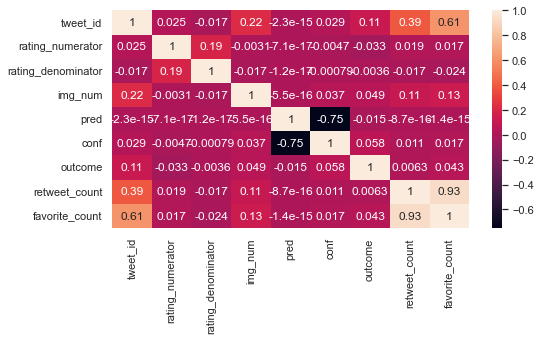

In [264]:
#check to see if there's any correlation between the variables
stat_corr = df.corr()
#sns.set(rc={'figure.figsize':(8,4)})
sns.heatmap(stat_corr, annot=True)
plt.show()

> Strong and postive correlation between retweet_count and favorite_count at 0.93. This is due to the fact that most people retweet 'tweets' that they save as favorites in for others to see it

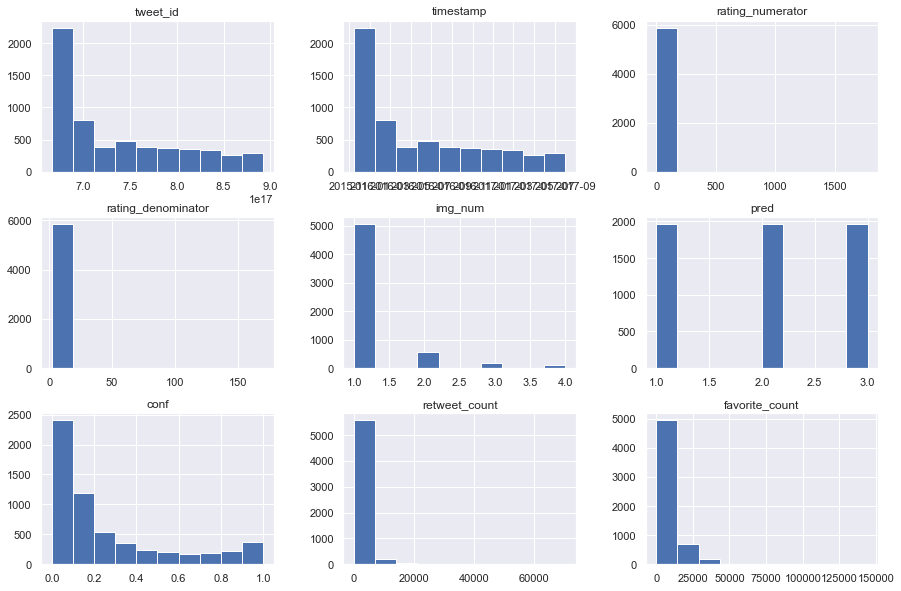

In [265]:
#Plot a histogram to view the distribution
df.hist(figsize=(15,10));

> Most of the variables are **Right Skewed Distributed** which means they tend to have least values appearing mostly

### Insights into the High and Low Prediction Accuracy

In [288]:
# Filter confidence level greater than 0.9 which will be later compared to that of the lower confidence 
conf_high = df[(df['conf']>=0.9) &(df['outcome']==True)]
print(conf_high)


                tweet_id                 timestamp  \
30    890006608113172480 2017-07-26 00:31:25+00:00   
36    889665388333682689 2017-07-25 01:55:32+00:00   
39    889638837579907072 2017-07-25 00:10:02+00:00   
42    889531135344209921 2017-07-24 17:02:04+00:00   
57    888078434458587136 2017-07-20 16:49:33+00:00   
...                  ...                       ...   
5679  667182792070062081 2015-11-19 03:29:07+00:00   
5709  667090893657276420 2015-11-18 21:23:57+00:00   
5763  666691418707132416 2015-11-17 18:56:35+00:00   
5790  666421158376562688 2015-11-17 01:02:40+00:00   
5802  666396247373291520 2015-11-16 23:23:41+00:00   

                                                   text  \
30    This is Koda. He is a South Australian decksha...   
36    Here's a puppo that seems to be on the fence a...   
39    This is Ted. He does his best. Sometimes that'...   
42    This is Stuart. He's sporting his favorite fan...   
57    This is Gerald. He was just told he didn't get... 

In [289]:
#Stats about the extracted higher than 0.9 confidence level
conf_high.describe()

,tweet_id,rating_numerator,rating_denominator,img_num,pred,conf,retweet_count,favorite_count
count,2.830000e+02,283.000000,283.000000,283.000000,283.0,283.000000,283.000000,283.000000
mean,7.478406e+17,11.508834,10.353357,1.328622,1.0,0.961163,2423.547703,8759.653710
std,7.120951e+16,4.894898,4.521291,0.735228,0.0,0.029377,3259.049471,11382.644456
min,6.663962e+17,3.000000,10.000000,1.000000,1.0,0.900000,41.000000,147.000000
25%,6.818630e+17,10.000000,10.000000,1.000000,1.0,0.939500,577.500000,2105.500000
50%,7.289864e+17,11.000000,10.000000,1.000000,1.0,0.965000,1298.000000,4507.000000
75%,8.078135e+17,12.000000,10.000000,1.000000,1.0,0.988000,3026.500000,11397.000000
max,8.900066e+17,80.000000,80.000000,4.000000,1.0,1.000000,30062.000000,108523.000000


> we can see that majority of those with a higher than 0.9 accuracy are from the first prediction p1 with a min at 1 and max at 1

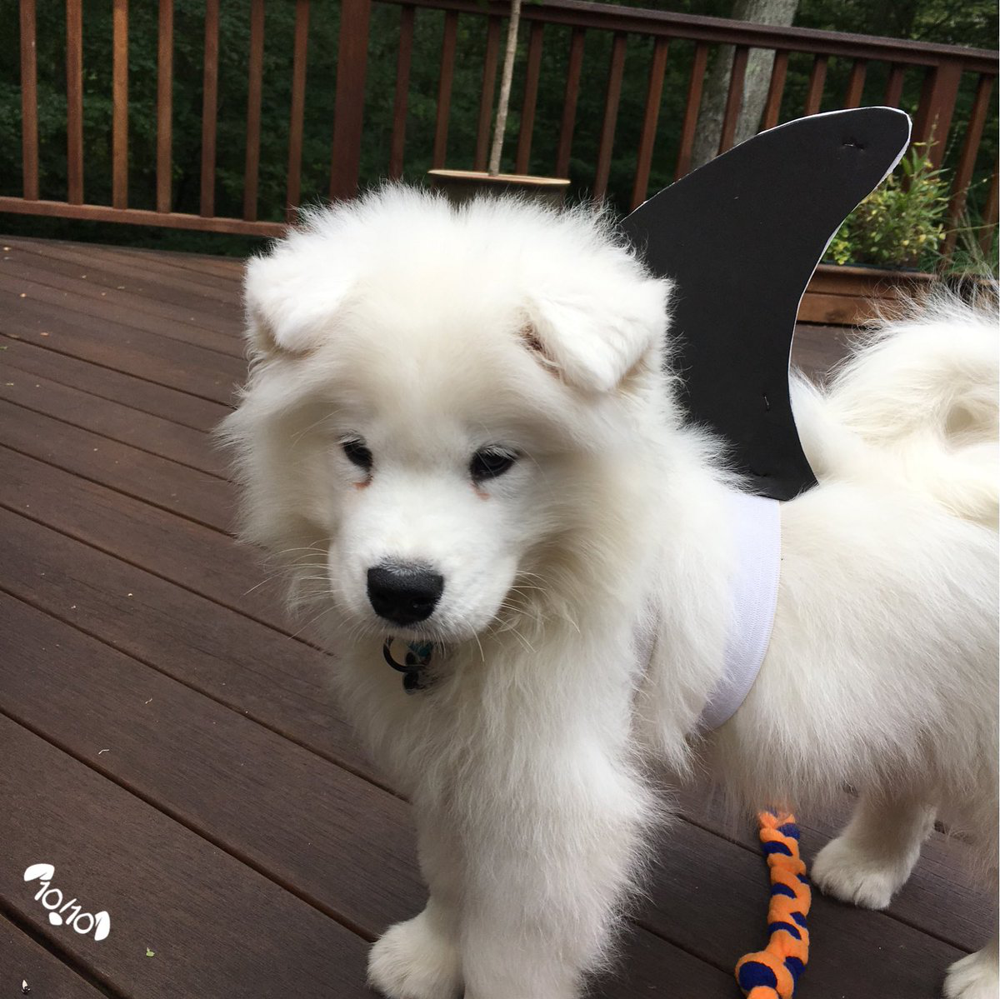

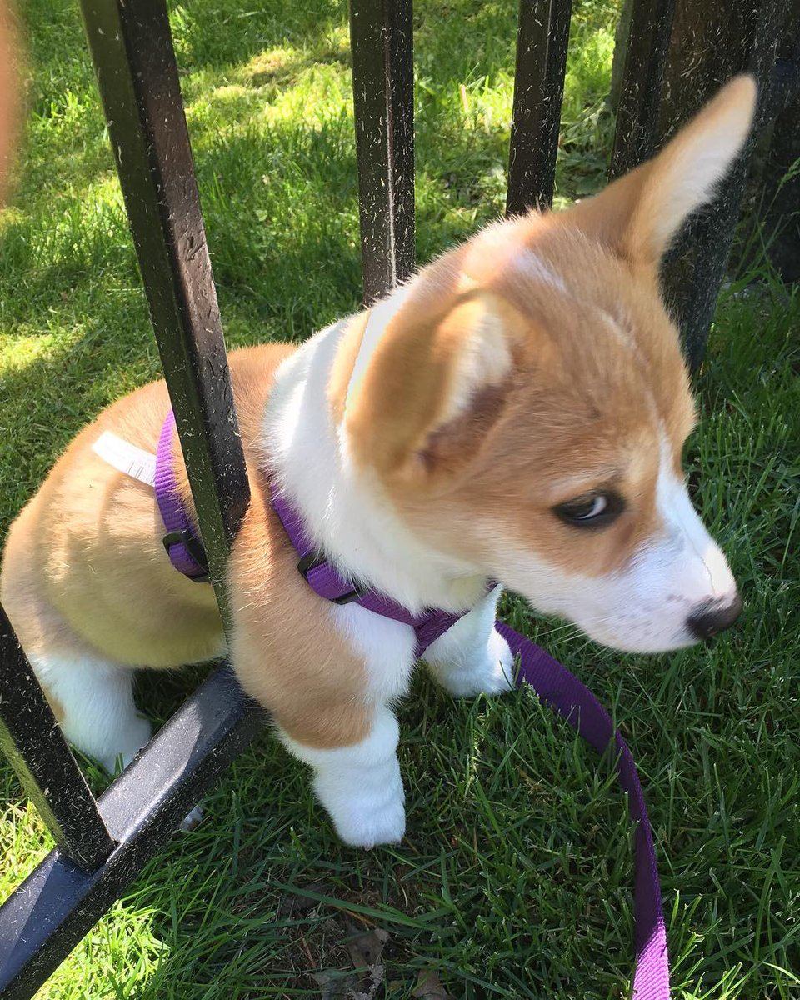

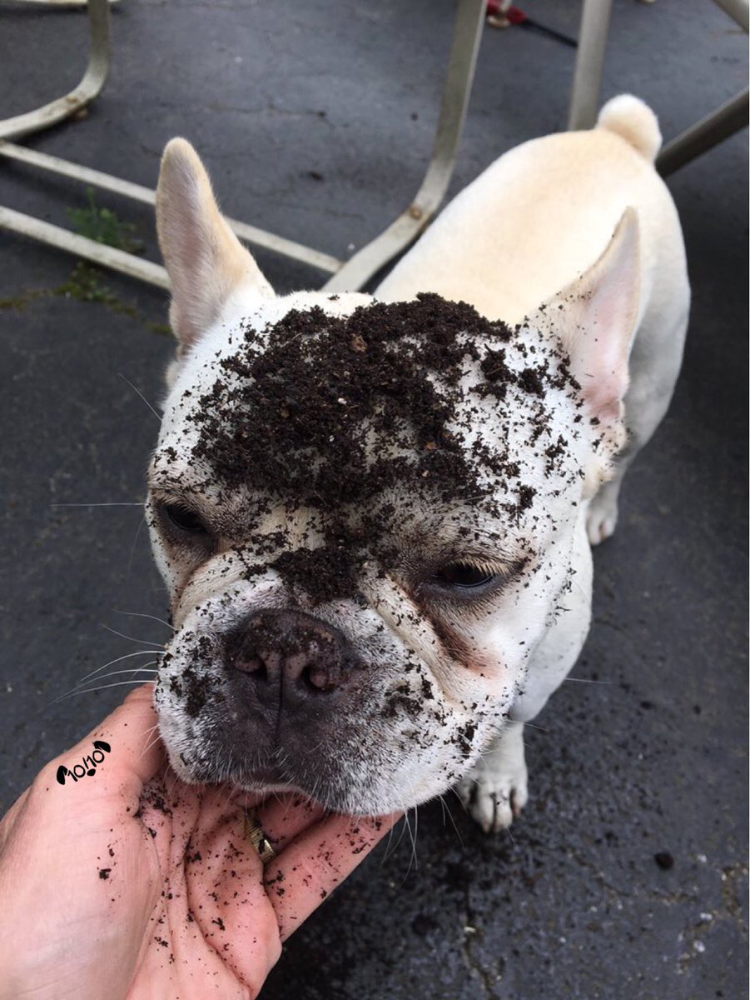

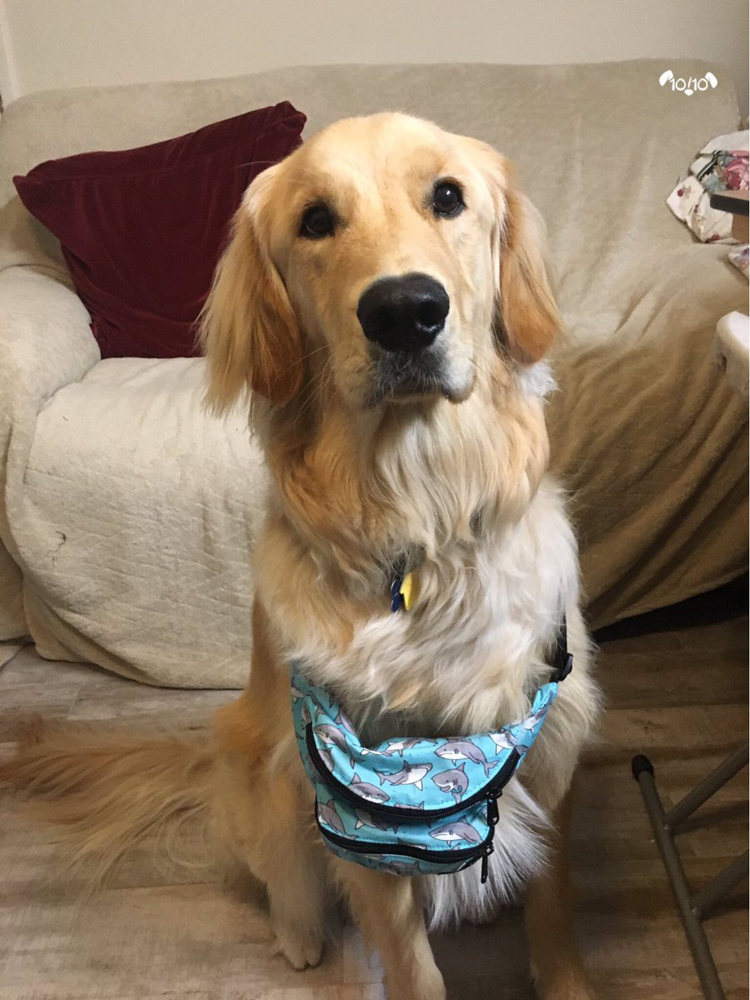

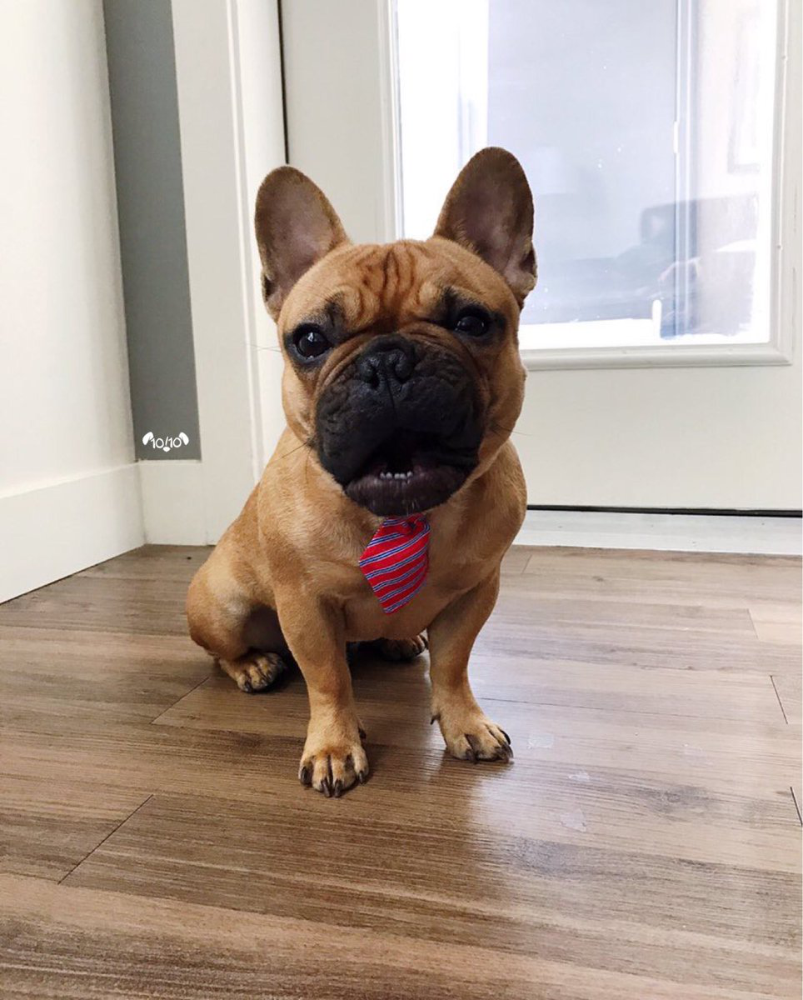

In [290]:
#View some images to confirm 
jpg_high=conf_high.jpg_url
# Forming in array inorder to process 5 images.
img_high = np.array(jpg_high[:5])
# Using requests library to obtain image data and PIL Image and BytesIo to read and show the content of the image.
img=[]
for i in range(img_high.shape[0]):
    url = img_high[i]
    r = requests.get(url)
    img.append(Image.open(BytesIO(r.content)))
#display images
for i in img:
    display(i)

> We can see the some of the images have a clear view of the dog hence a higher confident prediction, let's now confiirm this by comparing those with a lower confident prediction

In [296]:
# Filter confidence level less than 0.1
conf_low = df[df['conf']< 0.1]
print(conf_low)

                tweet_id                 timestamp  \
0     892420643555336193 2017-08-01 16:23:56+00:00   
1     892420643555336193 2017-08-01 16:23:56+00:00   
2     892420643555336193 2017-08-01 16:23:56+00:00   
4     892177421306343426 2017-08-01 00:17:27+00:00   
5     892177421306343426 2017-08-01 00:17:27+00:00   
...                  ...                       ...   
5867  666051853826850816 2015-11-16 00:35:11+00:00   
5870  666050758794694657 2015-11-16 00:30:50+00:00   
5881  666029285002620928 2015-11-15 23:05:30+00:00   
5882  666029285002620928 2015-11-15 23:05:30+00:00   
5885  666020888022790149 2015-11-15 22:32:08+00:00   

                                                   text  \
0     This is Phineas. He's a mystical boy. Only eve...   
1     This is Phineas. He's a mystical boy. Only eve...   
2     This is Phineas. He's a mystical boy. Only eve...   
4     This is Tilly. She's just checking pup on you....   
5     This is Tilly. She's just checking pup on you.... 

In [292]:
#Stats about the extracted less than 0.1 confidence level
conf_low.describe()

,tweet_id,rating_numerator,rating_denominator,img_num,pred,conf,retweet_count,favorite_count
count,1.716000e+03,1716.000000,1716.000000,1716.000000,1716.000000,1716.000000,1716.000000,1716.000000
mean,7.405449e+17,11.532051,10.582168,1.279720,2.639860,0.040728,2309.050117,8160.268065
std,6.839212e+16,7.868794,6.879446,0.656759,0.489799,0.030930,4052.622996,11907.910619
min,6.660209e+17,0.000000,2.000000,1.000000,1.000000,0.000000,35.000000,92.000000
25%,6.778951e+17,10.000000,10.000000,1.000000,2.000000,0.012000,533.750000,1923.000000
50%,7.152006e+17,11.000000,10.000000,1.000000,3.000000,0.037000,1183.000000,3823.500000
75%,7.943323e+17,12.000000,10.000000,1.000000,3.000000,0.068000,2630.750000,9975.250000
max,8.921774e+17,165.000000,150.000000,4.000000,3.000000,0.100000,70344.000000,144273.000000


> we can see that majority of those with a lower than 0.1 accuracy are from the third prediction p3 with a 50th and 75th percentile at 3

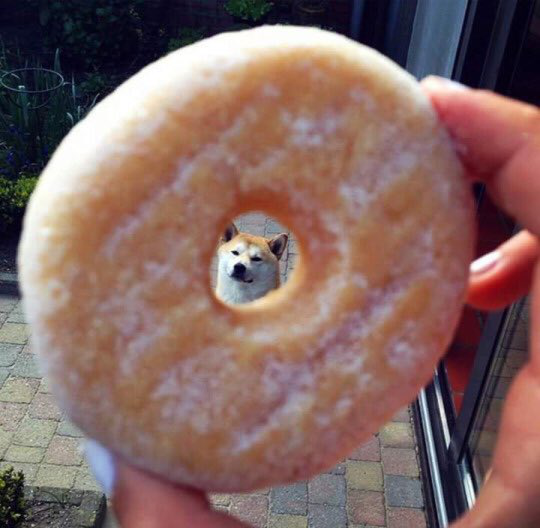

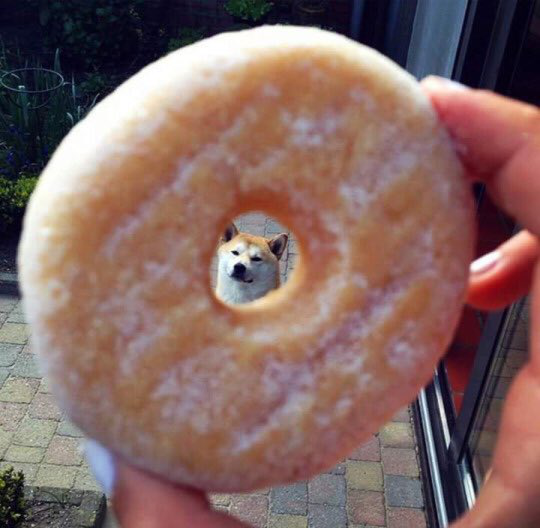

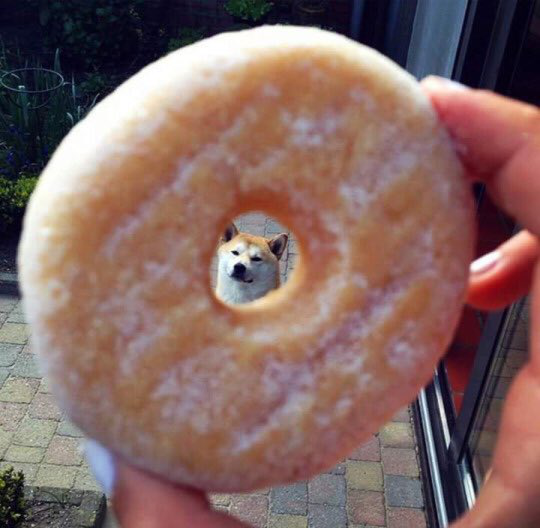

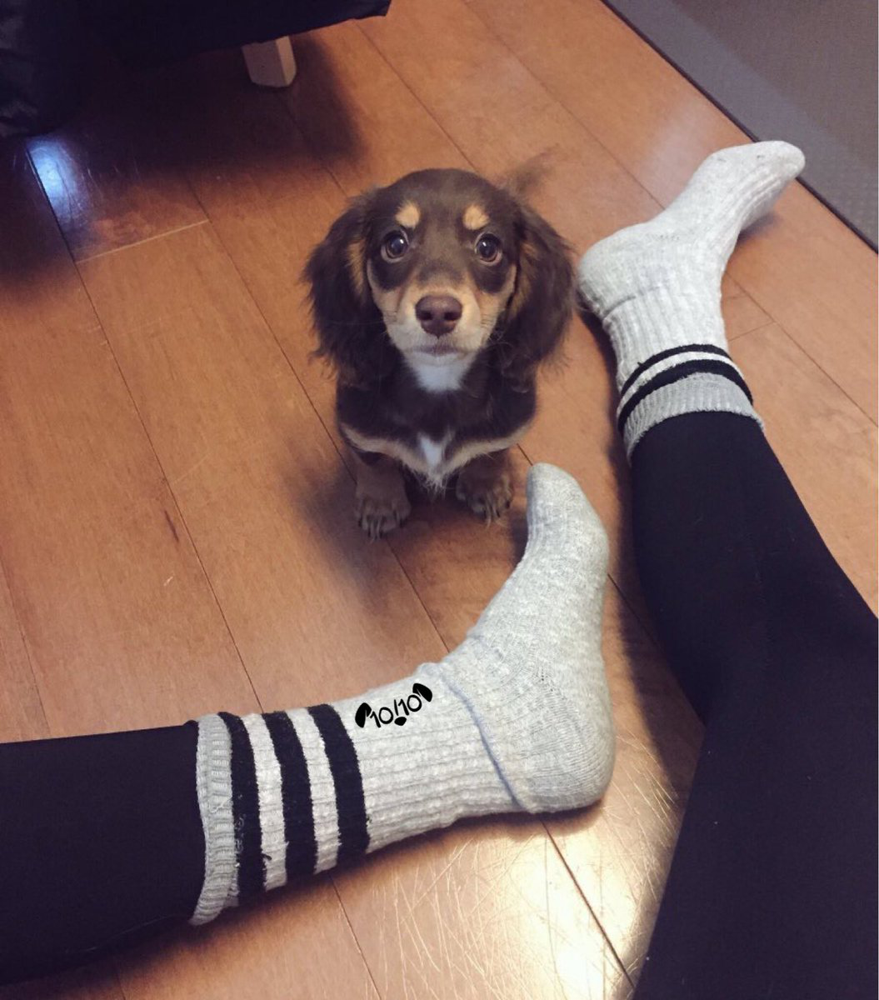

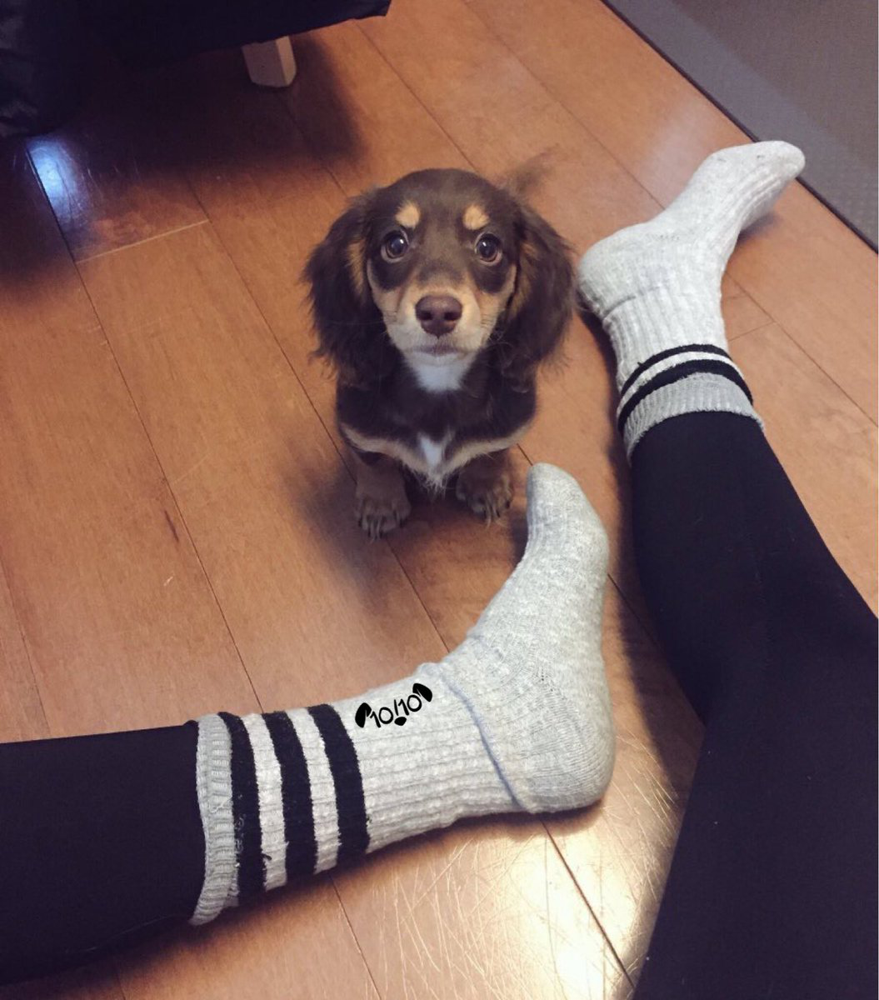

In [409]:
#View some images to confirm 
jpg_low=conf_low.jpg_url
# Forming in array inorder to process 5 images.
img_low = np.array(jpg_low[:5])
# Using requests library to obtain image data and PIL Image and BytesIo to read and show the content of the image.
img1=[]
for i in range(img_low.shape[0]):
    url = img_low[i]
    r = requests.get(url)
    img1.append(Image.open(BytesIO(r.content)))
#display images
for i in img1:
    display(i)

> In conclusion, we can say that those predictions with a high confidence level has images of the dogs very clear whilst those with a low prediction do not have a dog image or an unclear picture of the dog. This also means that the dog having a 100% accuracy has a very clear image of the dog. This confirmed in the below code cells

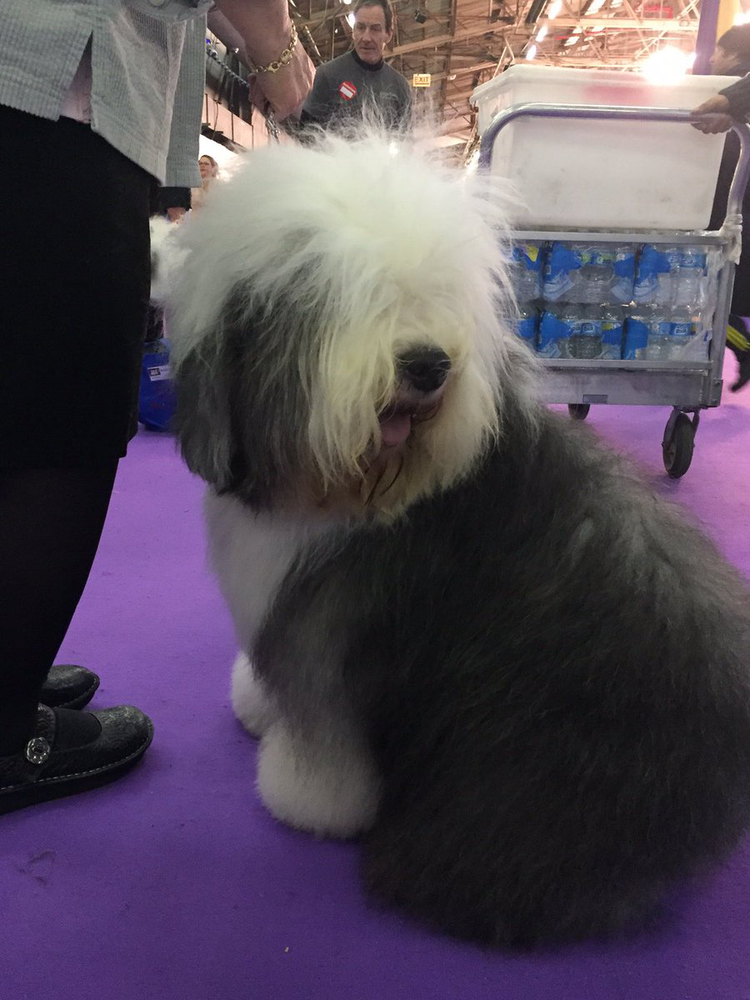

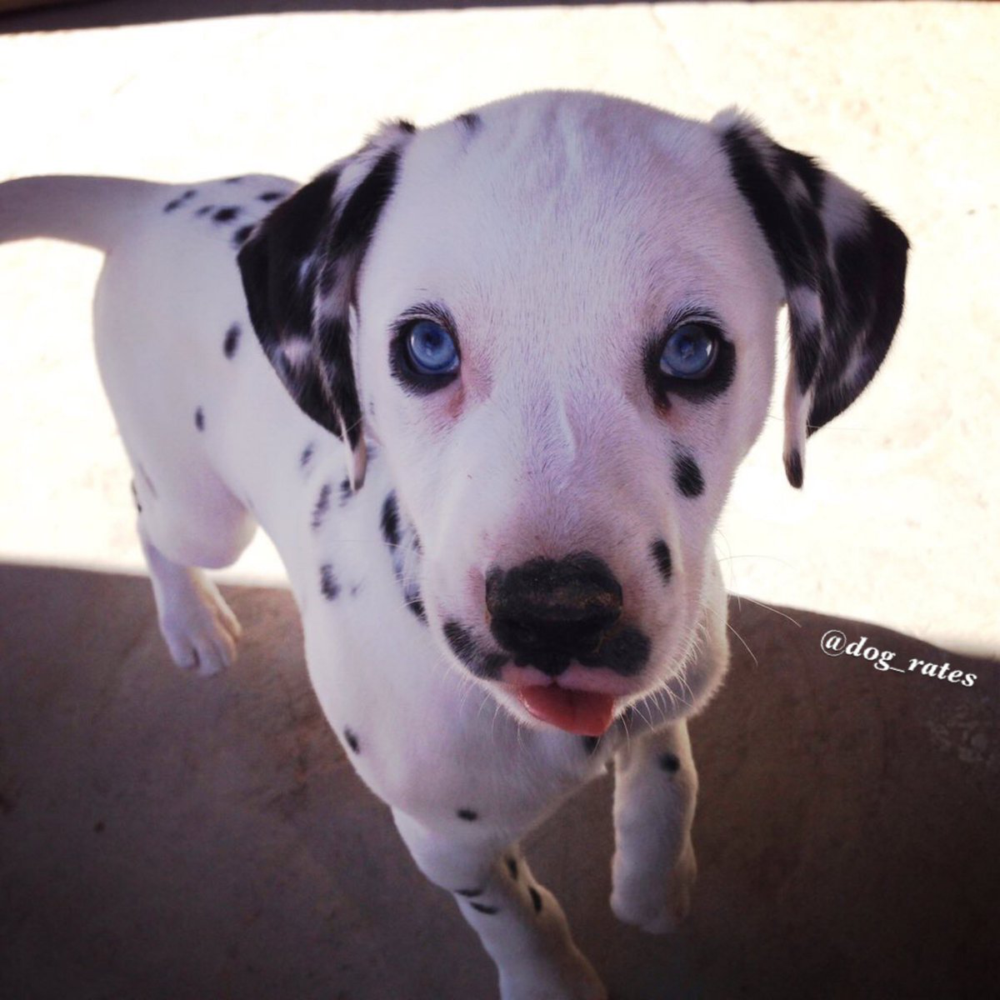

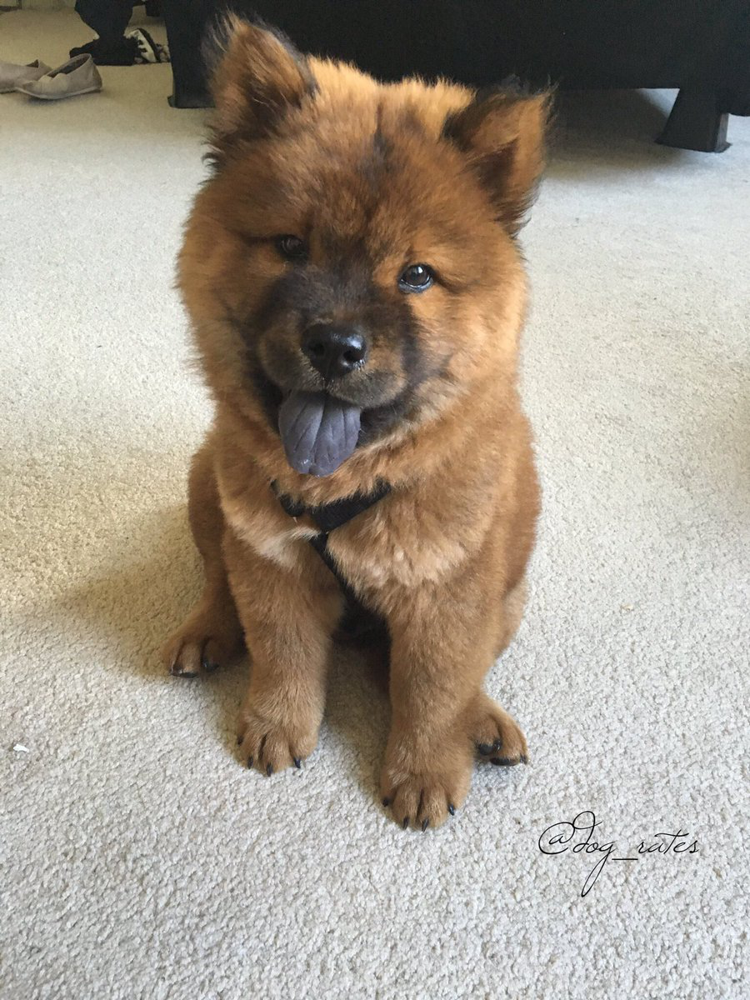

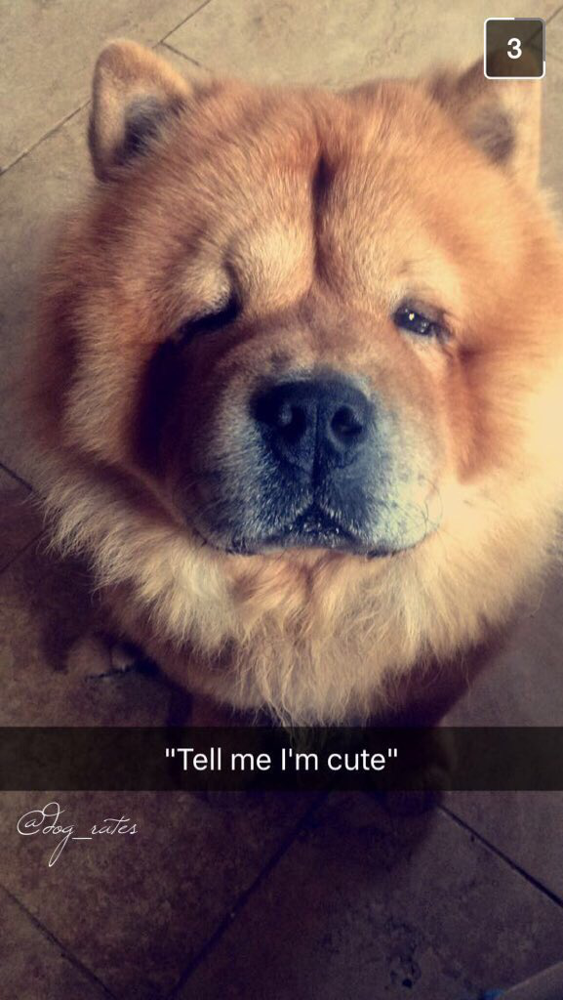

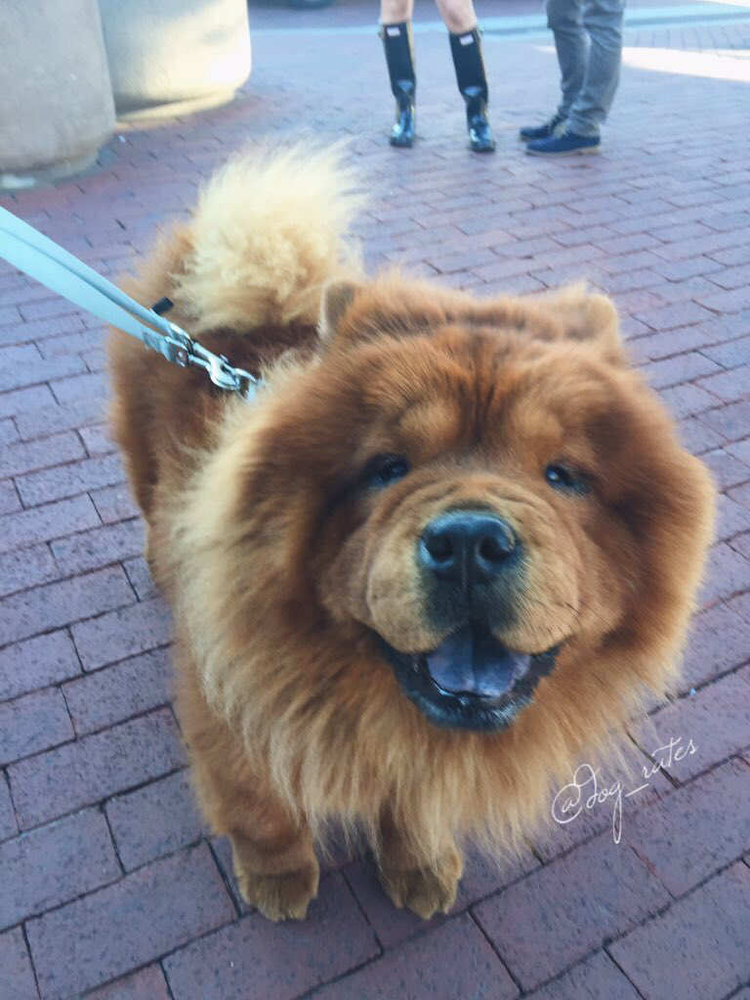

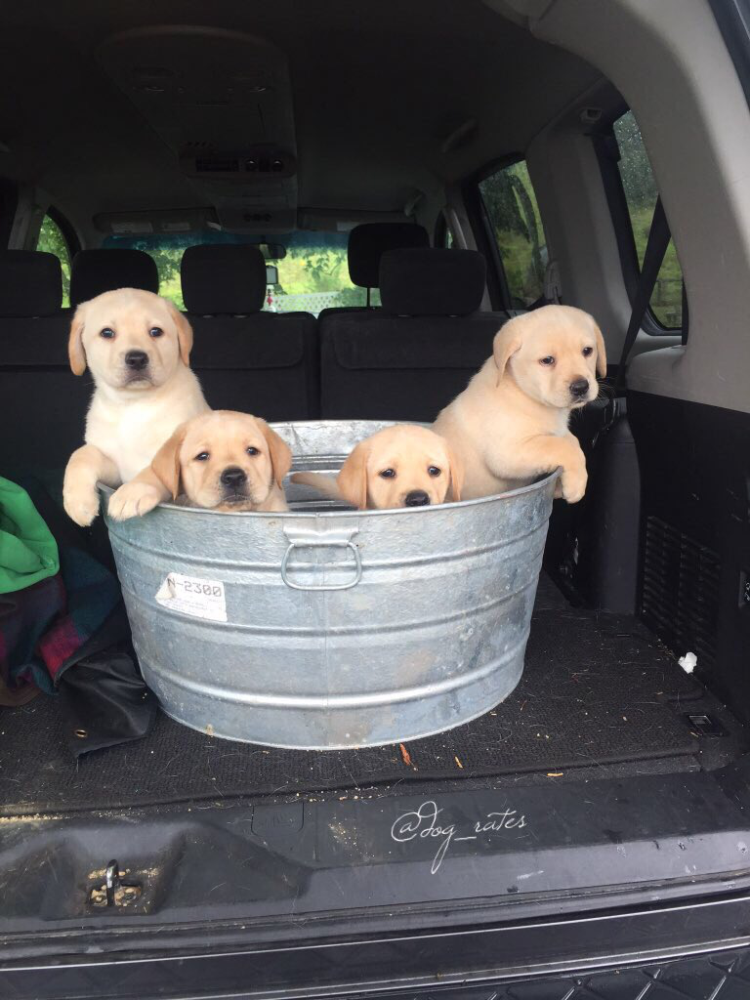

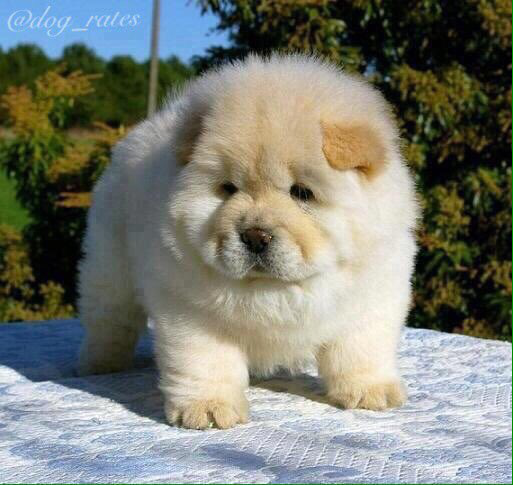

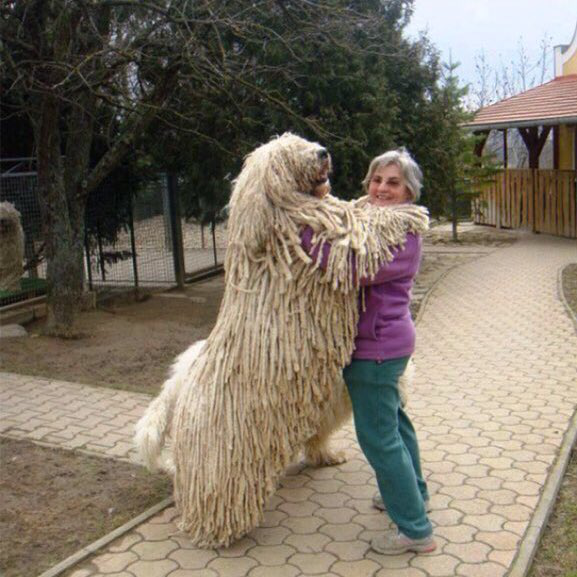

In [298]:
# Filter confidence level with 100%
conf_1 = df[(df['conf']==1) &(df['outcome']==True)]
#View some images to confirm 
jpg_1=conf_1.jpg_url
# Forming in array inorder to process 5 images.
img_1 = np.array(jpg_1[:5])
# Using requests library to obtain image data and PIL Image and BytesIo to read and show the content of the image.
imgs=[]
for i in range(img_1.shape[0]):
    url = img_1[i]
    r = requests.get(url)
    imgs.append(Image.open(BytesIO(r.content)))
#display images
for i in imgs:
    display(i)

> This confirms our earlier statement regarding dogs with 100% prediction confidence having a clear dog image

### Dogs stages with the highest favourite count

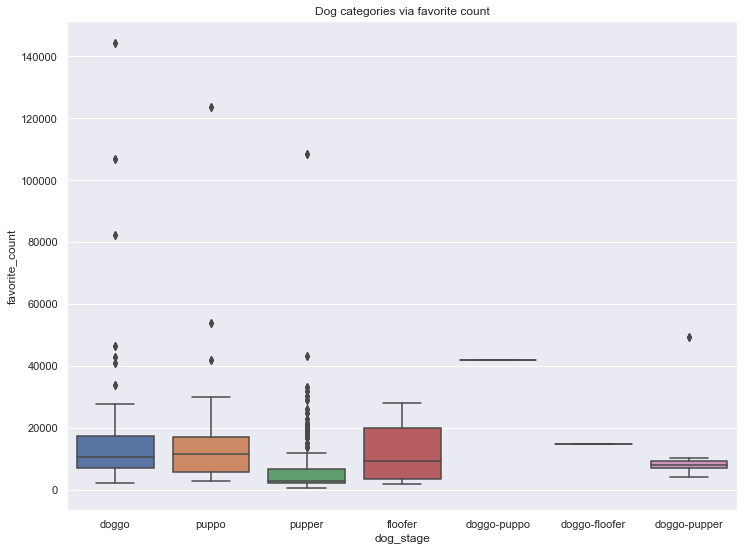

In [408]:
# A boxplot for dog stage excluding tweets with "None" grouped by favourite counts
top_dog=df.groupby("dog_stage").filter(lambda x: len(x) < 4983)
sns.set_style('whitegrid')
sns.set(rc={"figure.figsize":(12, 9)})
sns.boxplot(x = 'dog_stage', y = 'favorite_count', data = top_dog).set_title('Dog categories via favorite count');
plt.savefig('top_stage.png')


> The dog_stage puppo has more tweet that are favourite. Dog stage puppo has a higher median value and is distributed normally.This could be related to the fact that it has more entry than the rest of the dog. Dog stage floofer has more spread out favorite count. Favorite count for most of the dog stages tend to be postively skewed.


### Top Tweet Source

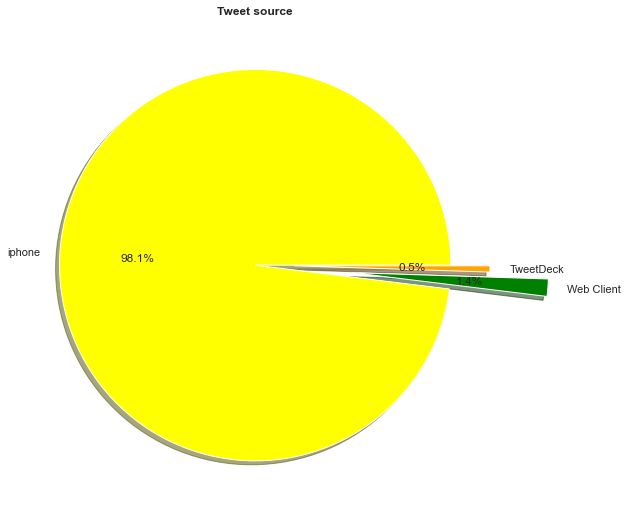

In [412]:
#Showing the percentage on a pie-chart

#  explode values
explode = (0.0, 0.5,0.2)
 
# color values
colors = ( 'yellow', 'green', 'orange')
          
# create and show plot
plt.pie (df['tweet_source'].value_counts(), autopct = '%1.1f%%', explode = explode,  labels=['iphone', 'Web Client', 'TweetDeck'],
         colors=colors, shadow =True, startangle = 360)
plt.title('Tweet source', fontweight ='bold')
plt.show
plt.savefig('top_source.png')
 

> 98% of twitter users tend to prefer using an iphone.

### Top 10 Dog Breeds (with high prediction confidence)

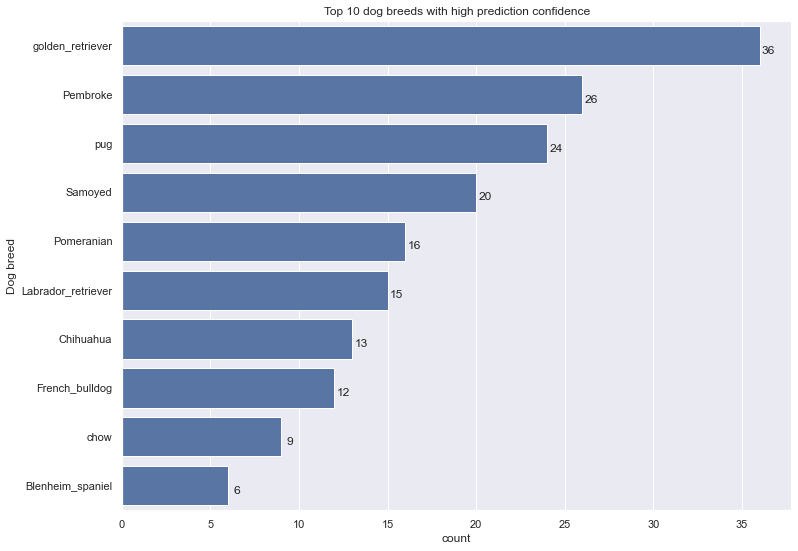

In [410]:
# conf_high variable already stores the extracted table. We plot a barchart with this.
sns.countplot(y='breed',data=conf_high,order=conf_high.breed.value_counts().index[:10],color=c)
# Add counts on top of each bar
for i in range(10):
    count = conf_high.breed.value_counts().values[i]
    plt.text(count+0.5, i, count, ha = 'center', va='top')
plotlabels('count','Dog breed' ,'Top 10 dog breeds with high prediction confidence')
plt.savefig('top_breeds.png')

> Golden retreiver has the highest count of entries at 36 with a high prediction confidence in the data

### Most Common Dog Names

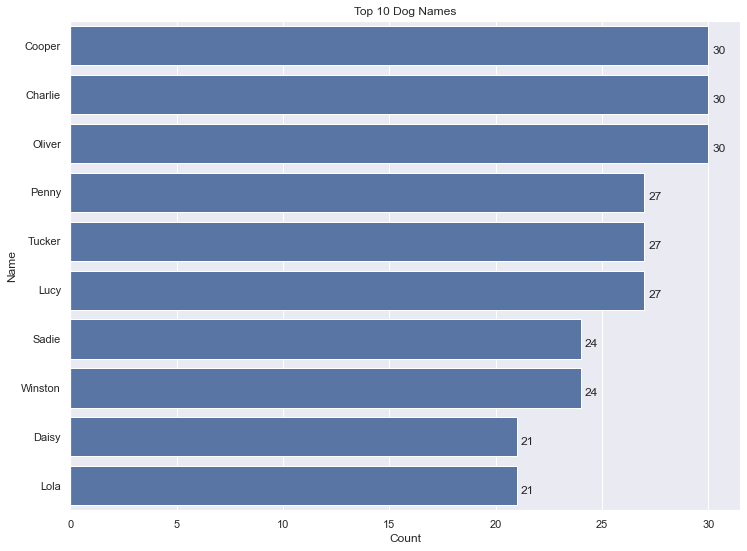

In [411]:
#Top 10 most common dog names exculding those with none values
top_name=df.groupby("name").filter(lambda x: len(x) < 1863)
sns.countplot(y='name',data=top_name,order=top_name.name.value_counts().index[:10],color=c)
# Add counts on top of each bar
for i in range(10):
    count = top_name.name.value_counts().values[i]
    plt.text(count+0.5, i, count, ha = 'center', va='top')
plotlabels('Count','Name' ,'Top 10 Dog Names')
plt.savefig('top_names.png');


> From this chart, we can see the top 3 dog Names excluding those with no names are Cooper, Charlie and Oliver

### Word Play (Frequently Used Tweet Words)

In [372]:
from wordcloud import STOPWORDS

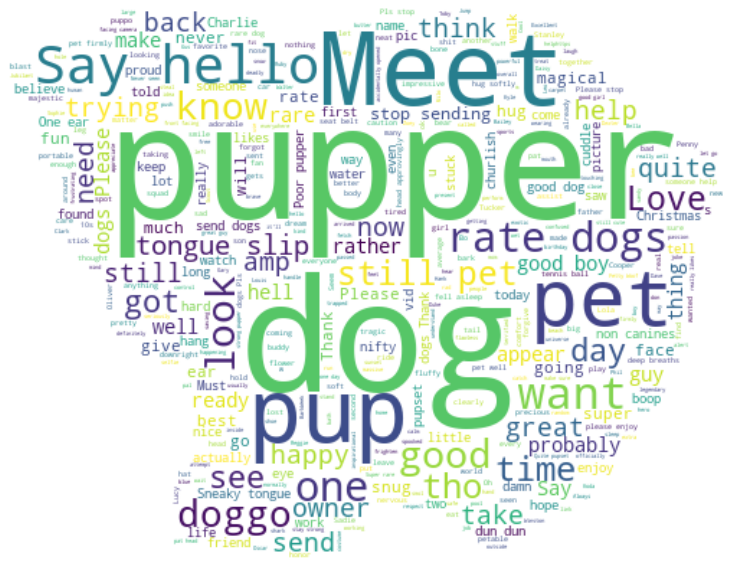

<Figure size 864x648 with 0 Axes>

In [413]:
#Checking the most frequently used words in the tweets and viewing them via word play
tweets = np.array(df.text)
txt_list = []
for tweet in tweets:
    txt_list.append(tweet.replace("\n",""))
mask = np.array(Image.open(requests.get('https://clipartix.com/wp-content/uploads/2016/09/Polar-bear-free-dog-clipart-1-page-of-public-domain-clip-art-image-2.jpg', stream=True).raw))
text1 = txt_list
stop_words = ["https", "co", "h", "t", "af", "ck", "ckin"] + list(STOPWORDS)
def drw_wc(text):
    wc = WordCloud(stopwords=stop_words,mask=mask, background_color='white',max_words=2000, max_font_size=256,
                   random_state=42, width=mask.shape[1],height=mask.shape[0])
    plt.figure(figsize=(10,8),facecolor = 'white', edgecolor='red')
    wc.generate(str(text1))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis('off')
    plt.tight_layout(pad=0)
    plt.show()
drw_wc(text1)
plt.savefig('top_words.png')

> Here we can see the most frequently used words in tweets such as **pupper**, **dog**, **Meet** etc

### Relationship between Retweet and Favorite count over time

In [414]:
#We will be using a time series for this analysis and hence we have to make time our index
#setting the DataFrame to index the timestamp column
df = df.set_index('timestamp')
df.sample(5)

,tweet_id,text,expanded_urls,rating_numerator,rating_denominator,name,dog_stage,tweet_source,jpg_url,img_num,pred,breed,conf,outcome,retweet_count,favorite_count
timestamp,,,,,,,,,,,,,,,,
2017-05-08 00:54:59+00:00,861383897657036800,This is Hobbes. He's never seen bubbles before...,https://twitter.com/dog_rates/status/861383897...,13,10,Hobbes,None,Twitter for iPhone,https://pbs.twimg.com/media/C_RAFTxUAAAbXjV.jpg,1,2,Pembroke,0.137,True,9228,32193
2016-11-01 00:00:38+00:00,793241302385262592,This is Tucker. He's out here bustin h*ckin gh...,https://twitter.com/dog_rates/status/793241302...,13,10,Tucker,None,Twitter for iPhone,https://pbs.twimg.com/media/CwIougTWcAAMLyq.jpg,1,1,golden_retriever,0.559,True,3063,9954
2015-11-17 01:02:40+00:00,666421158376562688,*internally screaming* 12/10 https://t.co/YMcr...,https://twitter.com/dog_rates/status/666421158...,12,10,None,None,Twitter for iPhone,https://pbs.twimg.com/media/CT-aggCXAAIMfT3.jpg,1,2,cocker_spaniel,0.090,True,90,272
2017-01-25 16:45:05+00:00,824297048279236611,This is Nala. She got in trouble. One h*ck of ...,https://twitter.com/dog_rates/status/824297048...,11,10,Nala,None,Twitter for iPhone,https://pbs.twimg.com/media/C3B9ypNWEAM1bVs.jpg,2,3,doormat,0.022,False,3553,14180
2016-05-20 00:51:30+00:00,733460102733135873,This is Hermione. Her face is as old as time. ...,https://twitter.com/dog_rates/status/733460102...,11,10,Hermione,None,Twitter for iPhone,https://pbs.twimg.com/media/Ci3GDeyUoAAKOxn.jpg,1,1,chow,0.931,True,1135,3865


In [421]:
retweetavg_mnth=df['retweet_count'].resample('W').mean()
print(retweetavg_mnth)

timestamp
2015-11-15 00:00:00+00:00     164.666667
2015-11-22 00:00:00+00:00     429.401460
2015-11-29 00:00:00+00:00     459.384058
2015-12-06 00:00:00+00:00     680.394737
2015-12-13 00:00:00+00:00     811.678899
                                ...     
2017-07-09 00:00:00+00:00    4991.166667
2017-07-16 00:00:00+00:00    5182.727273
2017-07-23 00:00:00+00:00    6232.200000
2017-07-30 00:00:00+00:00    5619.538462
2017-08-06 00:00:00+00:00    5235.666667
Freq: W-SUN, Name: retweet_count, Length: 91, dtype: float64


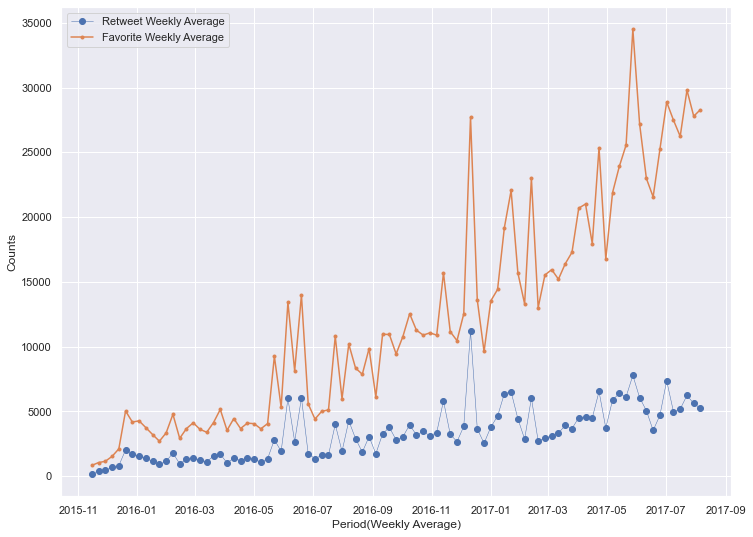

In [426]:
#plot a time series with variables retweet and favorite count over time based on weekly average counts
retweetavg_wk=df['retweet_count'].resample('W').mean()
favavg_wk=df['favorite_count'].resample('W').mean()
sns.set(rc={'figure.figsize':(12, 9)})
fig, ax = plt.subplots()
ax.plot(retweetavg_wk, marker='o', linestyle='-', linewidth=0.5, label='Retweet Weekly Average')
ax.plot(favavg_wk, marker='o', markersize=3, linestyle='-', label='Favorite Weekly Average')
ax.set_ylabel('Counts')
ax.set_xlabel('Period(Weekly Average)')
ax.legend();
plt.savefig('Weekly_Average.png')

> This is due to the fact that most people retweet 'tweets' that they like in order for others to see it. It is like 'free advertising' for the 'tweet' itself and shows people on your feed what you're interested in. It's a sharing feature when you want others to see something you've read/seen.
> From the above graph, we can that there are spikes/increase in retweets and favorite counts deviating from the normal continuous increase between the below months:
- 2015-12 to 2016-01 (Winter)
- 2016-06 to 2016-07 (Summer)
- 2016-12 to 2017-01 (Winter)
- 2017-06 to 2017-08 (Summer)
> The above shows that retweets and favorite counts are more likely to increase during the holidays.
> Generally this shows a progressive increase of counts over time.

<a id='conclusions'></a>
## Conclusions

> After having cleaned the data gathered from 3 data sources and merging them together to form one table, the below are the summary of the analysis performed.

1. A Strong and postive correlation between retweet_count and favorite_count at 0.93. This is due to the fact that most people retweet 'tweets' that they save as favorites in for others to see it.

2. There is a 100% prediction accuracy in the alogrithm, further checks revealed that this is due to the fact that the images which passed through the neural network was clear and not distorted with other image and was also an image of a dog.

3. The dog_stage puppo has tweet with high favourite counts. This could be due to the fact that most tweets in the data where relating to dogs in this stage and hence more likely to be liked.

4. Majority of tweets came from an iphone user. This means iphone users are more likely to have dogs.

5. The top 3 dog breeds with high confidence ratings and predicted to be a dog are golden retriever, Pembroke and pug.

6. Top 3 names likely for dogs to bear are Cooper, Charlie and Oliver.

7. Word Play art shows the mostly used words contained in tweets. They are Puppy, dog, pup, doggo, say, hello, meet, pet, dogs,rate amongst
others.

8. Lastly, the overall trend of the retweet and favorite count overtime shows a twitter page that keeps growing in counts from year 2015 to 2017 with spikes during holiday period which indicates users have more time to tweet and take pictures of their dog.
